In [1]:
import pandas as pd
import numpy as np
from PIL import Image
from sklearn.mixture import GaussianMixture 
import os
from matplotlib import pyplot as plt
from sklearn.cluster import KMeans
from sklearn import metrics

In [2]:
def image_segmentation(img,n,func):
    img_array=np.asarray(img)
    img_array = img_array.astype('float32')
    img_array /= 255
    img_array=img_array.reshape((img.size[0]*img.size[1],3))
    gm = GaussianMixture(n_components=n, random_state=0)
    gm.fit(img_array)
    gmm_labels=gm.predict(img_array)
    c=[]
    for i in range(n):
        c.append(func(img_array[gmm_labels==i],axis=0))
    c=np.array(c)
    new_img=c[gmm_labels]
    new_img=np.reshape(new_img,(img.size[1],img.size[0],3))
    return(new_img)

In [3]:
def image_segmentation_kmeans(img,n,func):
    img_array=np.asarray(img)
    img_array = img_array.astype('float32')
    img_array /= 255
    img_array=img_array.reshape(-1,3)
    kmean = KMeans(n_clusters=n, random_state=0)
    kmean.fit(img_array)
    c=[]
    for i in range(n):
        c.append(func(img_array[kmean.labels_==i],axis=0))
    c=np.array(c)
    new_img=c[kmean.labels_]
    new_img=np.reshape(new_img,(img.size[1],img.size[0],3))
    return(new_img)

### Primer 6.2.1

In [4]:
img = Image.open('slika.jpg')

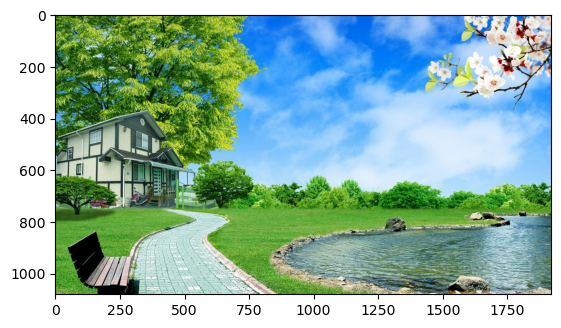

In [5]:
plt.imshow(img)
plt.show()

In [6]:
new_img=image_segmentation(img,n=3,func=np.median)

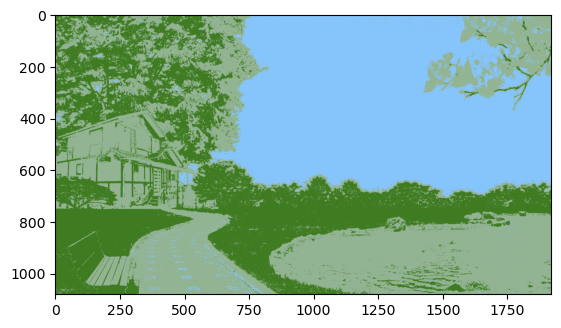

In [7]:
plt.imshow(new_img)
plt.show()

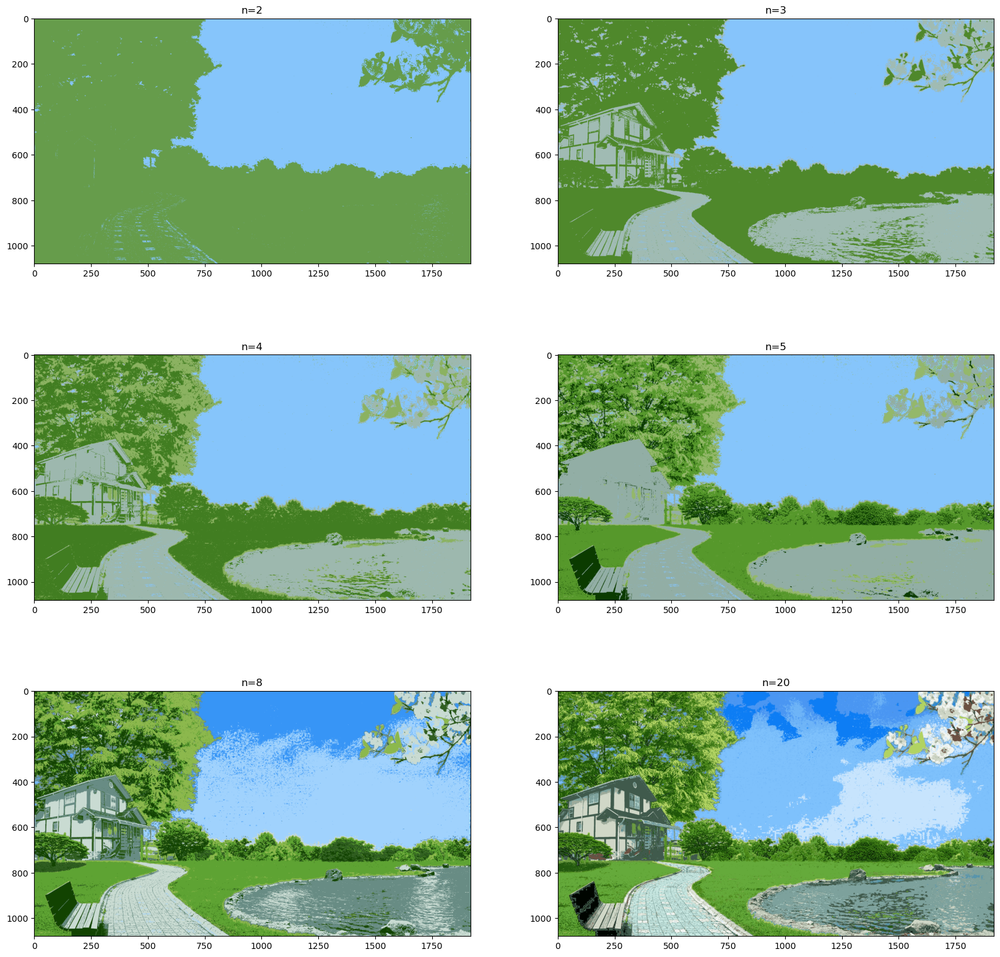

In [77]:
plt.figure(figsize=(20,20))
plt.subplot(3,2,1)
plt.title('n=2')
plt.imshow(image_segmentation(img,n=2,func=np.median))

plt.subplot(3,2,2)
plt.title('n=3')
plt.imshow(image_segmentation(img,n=3,func=np.median))

plt.subplot(3,2,3)
plt.title('n=4')
plt.imshow(image_segmentation(img,n=4,func=np.median))

plt.subplot(3,2,4)
plt.title('n=5')
plt.imshow(image_segmentation(img,n=5,func=np.median))

plt.subplot(3,2,5)
plt.title('n=8')
plt.imshow(image_segmentation(img,n=8,func=np.median))

plt.subplot(3,2,6)
plt.title('n=20')
plt.imshow(image_segmentation(img,n=20,func=np.median))

plt.show()

### Primer 6.2.2

In [8]:
img = Image.open('slika4.jpg')

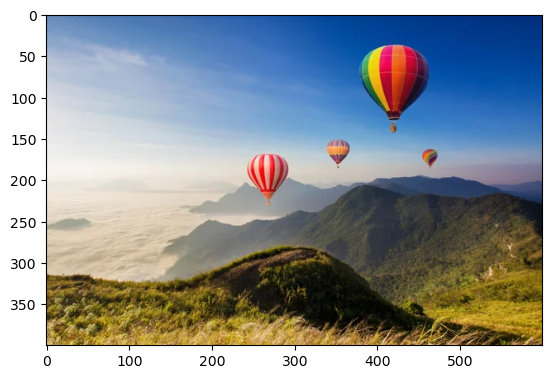

In [9]:
plt.imshow(img)
plt.show()

In [9]:
sil_score=[]
bic=[]
aic=[]
K=range(4,10)
for k in K:
    img_array=np.asarray(img)
    img_array = img_array.astype('float32')
    img_array /= 255
    img_array=img_array.reshape((img.size[0]*img.size[1],3))
    gm = GaussianMixture(n_components=k, random_state=0)
    gm.fit(img_array)
    labels = gm.predict(img_array)
    sil_score.append(metrics.silhouette_score(img_array, labels))
    bic.append(gm.bic(img_array))
    aic.append(gm.aic(img_array))


In [10]:
sil_score

[0.2304006, 0.19196329, 0.2217208, 0.19377816, 0.21369095, 0.25704166]

In [11]:
bic

[-1340816.2285456406,
 -1550499.9371089619,
 -1595774.333836328,
 -1677454.2577831775,
 -1685369.4966898172,
 -1730464.80105008]

In [12]:
aic

[-1341221.3759195313,
 -1551008.9684248758,
 -1596387.249094265,
 -1678171.056983138,
 -1686190.1798318007,
 -1731389.3681340867]

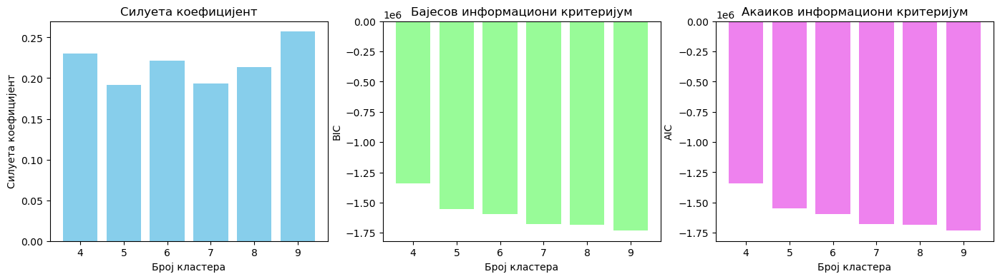

In [22]:
X = ['4','5','6','7','8','9']
X_axis = np.arange(len(X))

plt.figure(figsize=(17,4))

plt.subplot(1,3,1)
plt.bar(X_axis, sil_score, label = 'Силуета коефицијент',color='skyblue')  
plt.xticks(X_axis, X)
plt.xlabel("Број кластера")
plt.ylabel("Силуета коефицијент")
plt.title("Силуета коефицијент")

plt.subplot(1,3,2)
plt.bar(X_axis, bic, label = 'BIC',color='palegreen')  
plt.xticks(X_axis, X)
plt.xlabel("Број кластера")
plt.ylabel("BIC")
plt.title("Бајесов информациони критеријум")

plt.subplot(1,3,3)
plt.bar(X_axis, aic, label = 'AIC',color='violet')  
plt.xticks(X_axis, X)
plt.xlabel("Број кластера")
plt.ylabel("AIC")
plt.title("Акаиков информациони критеријум")

plt.show()

In [23]:
new_img=image_segmentation(img,n=9,func=np.median)

In [24]:
new_img_kmeans=image_segmentation_kmeans(img,n=9,func=np.median)

C:\Users\Bojana\anaconda3_v2\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


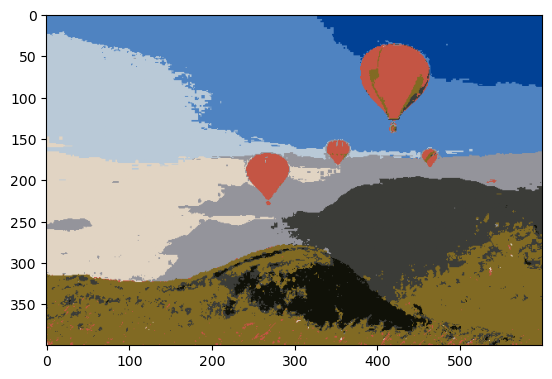

In [25]:
plt.imshow(new_img)
plt.show() 

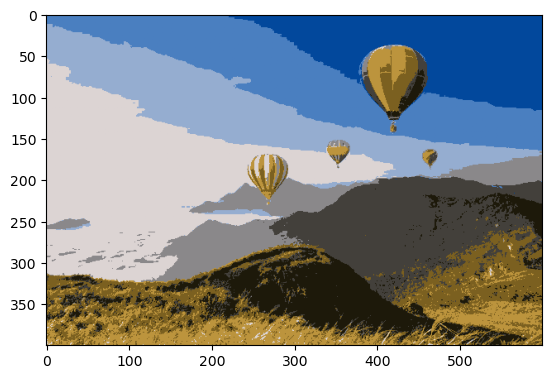

In [26]:
plt.imshow(new_img_kmeans)
plt.show() 

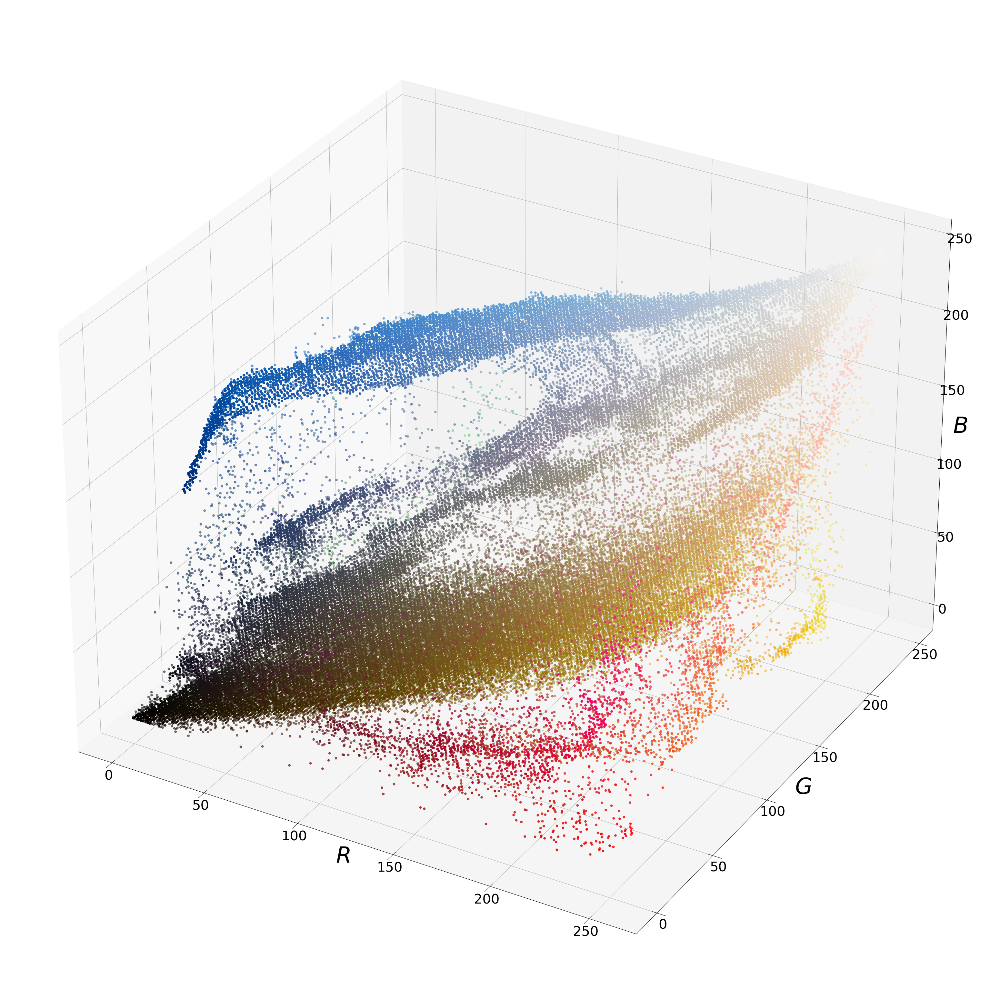

In [27]:
img_array=np.asarray(img).astype('float32')
img_array=img_array.reshape((-1,3))
fig = plt.figure(figsize=(40,40))
ax = fig.add_subplot(111, projection='3d')

ax.scatter(img_array[:,0],img_array[:,1],img_array[:,2], c = img_array/255.0)
ax.set_xlabel('$R$', fontsize=50)
ax.set_ylabel('$G$', fontsize=50)
ax.set_zlabel('$B$', fontsize=50)
ax.zaxis.set_tick_params(labelsize=30)
ax.xaxis.set_tick_params(labelsize=30)
ax.yaxis.set_tick_params(labelsize=30)


plt.show()

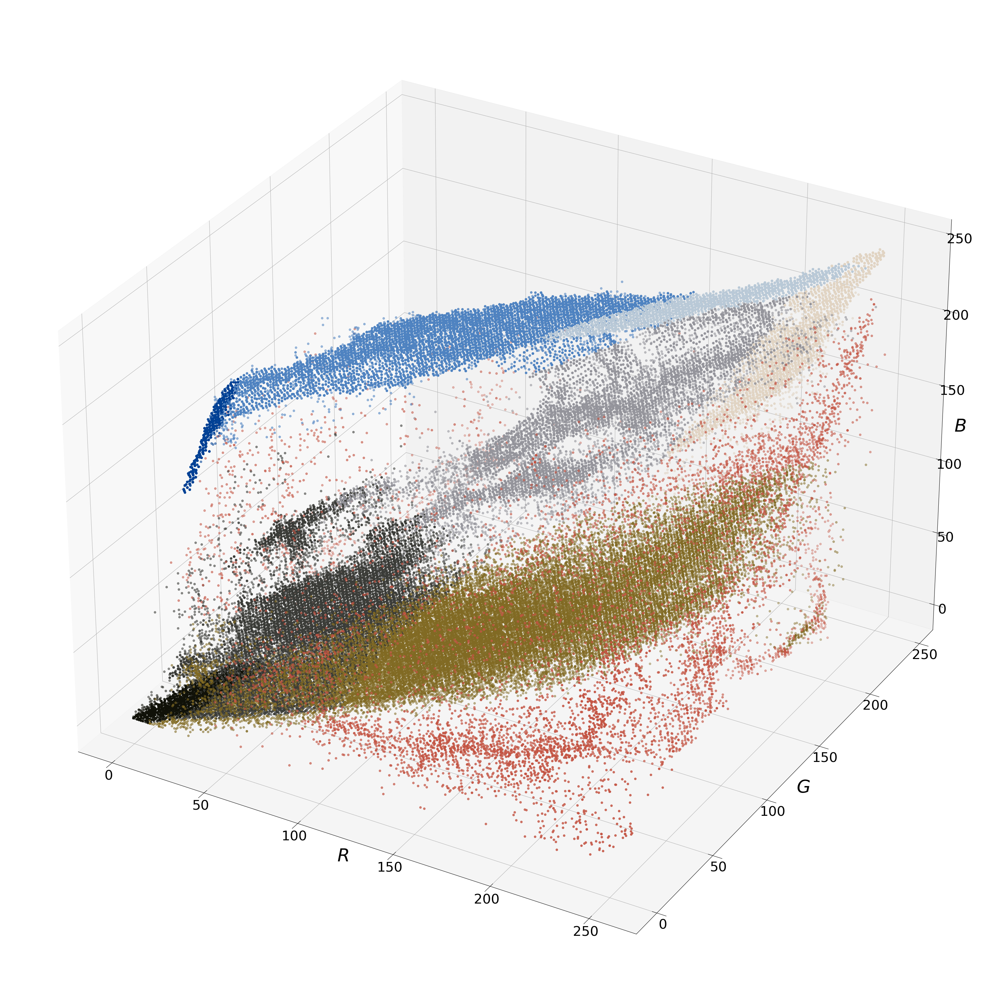

In [28]:
img_array=np.asarray(img).astype('float32')
img_array=img_array.reshape((-1,3))

fig = plt.figure(figsize=(40,40))
ax = fig.add_subplot(111, projection='3d')

ax.scatter(img_array[:,0],img_array[:,1],img_array[:,2], c = new_img.reshape((-1,3)))
ax.set_xlabel('$R$', fontsize=40)
ax.set_ylabel('$G$', fontsize=40)
ax.set_zlabel('$B$', fontsize=40)
ax.zaxis.set_tick_params(labelsize=30)
ax.xaxis.set_tick_params(labelsize=30)
ax.yaxis.set_tick_params(labelsize=30)

plt.show()

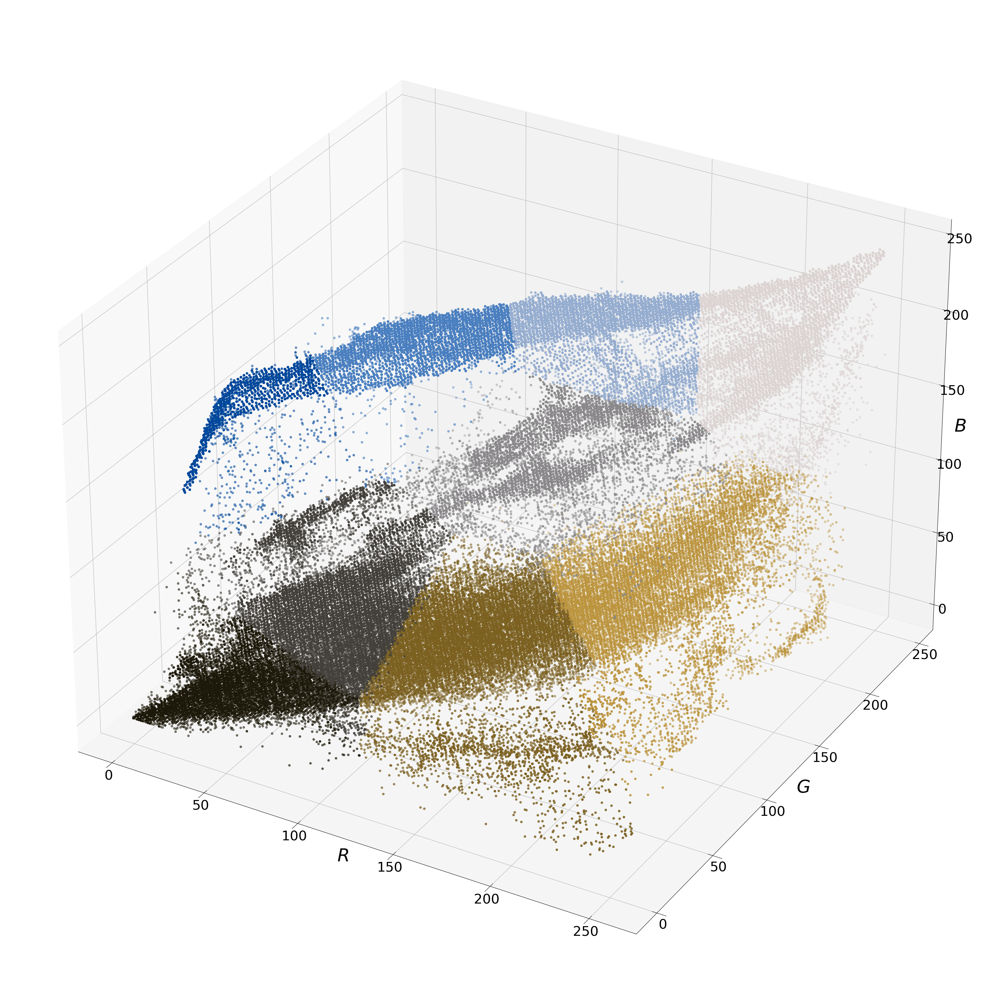

In [29]:
img_array=np.asarray(img).astype('float32')
img_array=img_array.reshape((-1,3))

fig = plt.figure(figsize=(40,40))
ax = fig.add_subplot(111, projection='3d')

ax.scatter(img_array[:,0],img_array[:,1],img_array[:,2], c = new_img_kmeans.reshape((-1,3)))

ax.set_xlabel('$R$', fontsize=40)
ax.set_ylabel('$G$', fontsize=40)
ax.set_zlabel('$B$', fontsize=40)
ax.zaxis.set_tick_params(labelsize=30)
ax.xaxis.set_tick_params(labelsize=30)
ax.yaxis.set_tick_params(labelsize=30)

plt.show()